# London Real Estate Pricing Analysis

## Introduction

Analyzing prices of various London properties using K-means clustering

# Importing Libraries

In [50]:
import numpy as np 
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import json 
import geocoder as geocoder
from geopy.geocoders import Nominatim 
import requests
from pandas.io.json import json_normalize 
import matplotlib.cm as cm
import matplotlib.colors as colors
from sklearn.cluster import KMeans
import folium 

# Scraping from various locations of London from Wikipedia

In [51]:
import pandas as pd
import wikipedia as wp
html = wp.page("List of areas of London").html().encode("UTF-8")
df = pd.read_html(html)[1]

### Locations table [TABLE 1] 

In [52]:
df.head()

,Location,London borough,Post town,Postcode district,Dial code,OS grid ref
0,Abbey Wood,"Bexley, Greenwich [7]",LONDON,SE2,020,TQ465785
1,Acton,"Ealing, Hammersmith and Fulham[8]",LONDON,"W3, W4",020,TQ205805
2,Addington,Croydon[8],CROYDON,CR0,020,TQ375645
3,Addiscombe,Croydon[8],CROYDON,CR0,020,TQ345665
4,Albany Park,Bexley,"BEXLEY, SIDCUP","DA5, DA14",020,TQ478728


In [53]:
df.columns

Index(['Location', 'London borough', 'Post town', 'Postcode district',
       'Dial code', 'OS grid ref'],
      dtype='object')

In [54]:
df.columns = ['Location','London_borough','Post town','Postcode district','Dial Code','OS grid ref']

## Cleaning the table

The table contains hyperlinks numbers and there are more than one Postal codes so I decided to keep one.

In [55]:
df['London_borough'] =  df['London_borough'].apply(lambda x: x.replace('[','').replace(']','')) 
df['London_borough'] =  df['London_borough'].str.replace('\d+', '')
df['London_borough'] =  df['London_borough'].str.split(',').str[0]
df['Postcode district'] =  df['Postcode district'].str.split(',').str[0]
df['Postcode district'] =  df['Postcode district'].str.split('(').str[0]
df['Post town'] =  df['Post town'].str.split(',').str[0]

C:\Users\KEVALP~1\AppData\Local\Temp/ipykernel_6012/1178698707.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df['London_borough'] =  df['London_borough'].str.replace('\d+', '')


In [56]:
df.head()

,Location,London_borough,Post town,Postcode district,Dial Code,OS grid ref
0,Abbey Wood,Bexley,LONDON,SE2,020,TQ465785
1,Acton,Ealing,LONDON,W3,020,TQ205805
2,Addington,Croydon,CROYDON,CR0,020,TQ375645
3,Addiscombe,Croydon,CROYDON,CR0,020,TQ345665
4,Albany Park,Bexley,BEXLEY,DA5,020,TQ478728


In [57]:
df.to_csv('london.csv',index=False)

In [58]:
df.shape

(532, 6)

# Scrapping property data of London from propertydata.co.uk

In [59]:
from urllib.request import Request, urlopen

req = Request(
    url='https://propertydata.co.uk/cities/london', 
    headers={'User-Agent': 'Mozilla/5.0'}
)
webpage = urlopen(req).read()

In [60]:
url = 'https://propertydata.co.uk/cities/london'
response = requests.get(url)

In [61]:
from bs4 import BeautifulSoup

soup = BeautifulSoup(response.text, 'html.parser')

In [62]:
table = soup.find('table')

In [63]:
data = []

for row in table.find_all('tr'):
    cols = row.find_all('td')
    cols = [ele.text.strip() for ele in cols]
    data.append([ele for ele in cols if ele])

df2 = pd.DataFrame(data)

In [64]:
df2.rename(columns = {0:"Postcode district",1:"Avg asking price",2:"Avg rental yeild",3:"Sales per month",4:"Avg sold £/sqft",5:"Explore more"}, inplace = True)
df2.drop(0,axis = 0,inplace=True)

### Property Table [TABLE 2]

In [65]:
df2

,Postcode district,Avg asking price,Avg rental yeild,Sales per month,Avg sold £/sqft,Explore more
1,BR1,"£502,640",4.3%,33,£492,Trend\n Explore
2,BR2,"£601,992",3.8%,34,£512,Trend\n Explore
3,BR3,"£583,182",3.5%,38,£532,Trend\n Explore
4,BR4,"£702,963",-,9,£513,Trend\n Explore
5,BR5,"£468,255",4.7%,35,£475,Trend\n Explore
6,BR6,"£611,246",3.7%,29,£514,Trend\n Explore
7,BR7,"£644,932",3.9%,14,£546,Trend\n Explore
8,BR8,"£429,166",4.4%,17,£408,Trend\n Explore
9,CR0,"£381,415",5.1%,82,£443,Trend\n Explore
10,CR2,"£506,518",3.9%,34,£469,Trend\n Explore


In [66]:
df2.columns

Index(['Postcode district', 'Avg asking price', 'Avg rental yeild',
       'Sales per month', 'Avg sold £/sqft', 'Explore more'],
      dtype='object')

# Cleaning Property Table [TABLE 2]

- Removing unwanted columns - Avg rental yield, Sales per month, Avg sold £/sqft, Explore more
- Removing '£' and commas from price column
- Renaming column "Postcode district " to "Area" and "Avg asking price" to "Avg price"

In [67]:
df2.drop(columns=['Avg rental yeild','Sales per month','Avg sold £/sqft','Explore more'], axis =1,inplace=True)

In [68]:
df2.rename(columns = {"Postcode district":"Area","Avg asking price":"Avg price"}, inplace = True)


In [69]:
df2.head()

,Area,Avg price
1,BR1,"£502,640"
2,BR2,"£601,992"
3,BR3,"£583,182"
4,BR4,"£702,963"
5,BR5,"£468,255"


In [70]:
df2['Avg price'] = df2['Avg price'].str.replace("£","")
df2['Avg price'] = df2['Avg price'].str.replace(',', '')
df2['Avg price'] = pd.to_numeric(df2['Avg price'])

In [71]:
df2.head()

,Area,Avg price
1,BR1,502640
2,BR2,601992
3,BR3,583182
4,BR4,702963
5,BR5,468255


In [72]:
df2.columns=['Postcode district','Avg price']

In [73]:
df2.to_csv('london_postcode.csv',index=False)

### Merging TABLE 1 [Locations table] and TABLE 2 [Property Table] to TABLE 3

In [74]:
#inner joint because there were many postcodes that were not in the London Borough's table
data=pd.merge(df, df2, how='inner', left_on='Postcode district', right_on='Postcode district')

### Finding Longitude and Latitude of the Locations
- Extracting latitudes and longitutes of all the locations using 'Postcode District' from the merged table 

In [75]:
def getLatLong(row):
    #print('post :{}'.format(row[:]))
    #print('neigh :{}'.format(row[1]))
    # initialize your variable to None
    lat_lng_coords = None
    search_query = '{}, London,UK'.format(row)
    # loop until you get the coordinates
    try:
        while(lat_lng_coords is None):
            #g = geocoder.here(search_query,app_id=app_id,app_code=app_code)
            g = geocoder.arcgis(search_query)
            lat_lng_coords = g.latlng
            #print('FIRST')
    except IndexError:
        latitude = 0.0
        longitude = 0.0
        print('BACKUP')
        return [latitude,longitude]

    latitude = lat_lng_coords[0]
    longitude = lat_lng_coords[1]
    print(latitude, longitude)
    return [latitude, longitude]

In [76]:
coords_list = data['Postcode district'].apply(getLatLong).tolist()

51.499741613000026 0.12406168200004686
51.499741613000026 0.12406168200004686
51.499741613000026 0.12406168200004686
51.521205000000066 -0.27397542799997154
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.52410000000003 -0.11164999999994052
51.52410000000003 -0.11164999999994052
51.51462500100007 -0.11486033199997792
51.51462500100007 -0.11486033199997792
51.51462500100007 -0.11486033199997792
51.51462500100007 -0.11486033199997792
51.507408360000056 -0.12769869299995662
51.507408360000056

51.573064620453266 0.1482251074934301
51.48512614800006 0.029115000000047075
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.50227000000007 -0.07645711499992558
51.50227000000007 -0.07645711499992558
51.50227000000007 -0.07645711499992558
51.50227000000007 -0.07645711499992558
51.646807539000065 0.0027100000000359614
51.646807539000065 0.0027100000000359614
51.41019000000006 0.06079682400002184
51.4101

51.43677000000008 -0.2570562169999562
51.507408360000056 -0.12769869299995662
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.53712499900007 -0.18195847999993475
51.53712499900007 -0.18195847999993475
51.51445617600007 -0.058209999999974116
51.51445617600007 -0.058209999999974116
51.528185000000065 -0.1850802839999801
51.528185000000065 -0.1850802839999801
51.392200176000074 -0.21594999899997447
51.392200176000074 -0.21594999899997447
51.392200176000074 -0.21594999899997447
51.392200176000074 -0.21594999899997447
51.52080500000005 -0.06353187499996693
51.52080500000005 -0.06353187499996693
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.40262500000006 -0.14363752499997418
51.393815000000075 -0.24302518199993983


## Merging the values in the dataframe

In [78]:
data[['Latitude','Longitude']]=pd.DataFrame(coords_list,columns=['Latitude', 'Longitude'])
data.head()

,Location,London_borough,Post town,Postcode district,Dial Code,OS grid ref,Avg price,Latitude,Longitude
0,Abbey Wood,Bexley,LONDON,SE2,020,TQ465785,409888,51.499742,0.124062
1,Crossness,Bexley,LONDON,SE2,020,TQ480800,409888,51.499742,0.124062
2,West Heath,Bexley,LONDON,SE2,020,TQ475775,409888,51.499742,0.124062
3,Acton,Ealing,LONDON,W3,020,TQ205805,518762,51.521205,-0.273975
4,Addington,Croydon,CROYDON,CR0,020,TQ375645,381415,51.384755,-0.051498


In [79]:
data

,Location,London_borough,Post town,Postcode district,Dial Code,OS grid ref,Avg price,Latitude,Longitude
0,Abbey Wood,Bexley,LONDON,SE2,020,TQ465785,409888,51.499742,0.124062
1,Crossness,Bexley,LONDON,SE2,020,TQ480800,409888,51.499742,0.124062
2,West Heath,Bexley,LONDON,SE2,020,TQ475775,409888,51.499742,0.124062
3,Acton,Ealing,LONDON,W3,020,TQ205805,518762,51.521205,-0.273975
4,Addington,Croydon,CROYDON,CR0,020,TQ375645,381415,51.384755,-0.051498
5,Addiscombe,Croydon,CROYDON,CR0,020,TQ345665,381415,51.384755,-0.051498
6,Coombe,Croydon,CROYDON,CR0,020,TQ342647,381415,51.384755,-0.051498
7,Croydon,Croydon,CROYDON,CR0,020,TQ335655,381415,51.384755,-0.051498
8,Forestdale,Croydon,CROYDON,CR0,020,TQ366625,381415,51.384755,-0.051498
9,New Addington,Croydon,CROYDON,CR0,020,TQ382622,381415,51.384755,-0.051498


### Removing unwanted columns from TABLE 3
- Columns removed are - 'Post town','Dial Code','OS grid ref' 

In [80]:
data.drop(columns=['Post town','Dial Code','OS grid ref'],inplace=True)

In [81]:
data.head()

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude
0,Abbey Wood,Bexley,SE2,409888,51.499742,0.124062
1,Crossness,Bexley,SE2,409888,51.499742,0.124062
2,West Heath,Bexley,SE2,409888,51.499742,0.124062
3,Acton,Ealing,W3,518762,51.521205,-0.273975
4,Addington,Croydon,CR0,381415,51.384755,-0.051498


In [103]:
data.shape

(530, 6)

#### Use geopy library to get the latitude and longitude values of London.

In [82]:
address = 'London'

geolocator = Nominatim(user_agent="ldn_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of London are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of London are 51.5073359, -0.12765.


### Creating a map of London with neighborhoods locations superimposed on top.

In [87]:
map_london = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(data['Latitude'], data['Longitude'], data['London_borough'], data['Location']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_london)  
    
map_london

### Define Foursquare Credentials and Version

In [88]:
CLIENT_ID = 'U0OWUYRP10WK5UFHIVQGDEKRQLZBSFYRALYTWAF0OBVJHIZ4' # your Foursquare ID
CLIENT_SECRET = 'R2BLV2WI204CLFJ5GTAS1OR0U2AFMKZV5UTWI20OREP30SZQ' # your Foursquare Secret
VERSION = '20180604'
#CLIENT_ID = 'SHP50I1LL2EPD4E31W2ZK3KXPCPUJHCO3UGX0V4DUAO3TIGY' # your Foursquare ID
#CLIENT_SECRET = 'D4J2J1PGYEYVOX0YRRHZ250EHDQZRKVYS30DSXZDVX5D1HU5' # your Foursquare Secret
#VERSION = '20210605'

### Exploring neighbourhoods of various location in TABLE 3
- The FourSquare API will help in extracting various venues located in different neighbourhoods of London gathered in Table 3

In [89]:
def getBuiltUrl(neigh_lat,neigh_long,radius=1400):
    # type your answer here
    LIMIT=100
    #radius=1000
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neigh_lat, 
    neigh_long, 
    radius, 
    LIMIT)
    return url

## Exploring first Location in our dataframe

In [90]:
neigh_name, neigh_borough, neigh_post, neigh_price, neigh_lat, neigh_long = data.iloc[0]
print('Latitude and longitude values of {} are {}, {}.'.format(neigh_name, 
                                                               neigh_lat, 
                                                               neigh_long))
results = requests.get(getBuiltUrl(neigh_lat,neigh_long))
print(results)
results = results.json()
print(results)

Latitude and longitude values of Abbey Wood are 51.499741613000026, 0.12406168200004686.
<Response [200]>
{'meta': {'code': 200, 'requestId': '6501f7434e040867b2c1354e'}, 'response': {'venues': [{'id': '63d1585c7bced4695b043bff', 'name': 'Greenwich Dance At The Nest', 'location': {'address': 'Cygnet Square', 'lat': 51.497955, 'lng': 0.12379836, 'labeledLatLngs': [{'label': 'display', 'lat': 51.497955, 'lng': 0.12379836}], 'distance': 199, 'postalCode': 'SE2 9FA', 'cc': 'GB', 'city': 'London', 'state': 'Greater London', 'country': 'United Kingdom', 'formattedAddress': ['Cygnet Square', 'London', 'Greater London', 'SE2 9FA', 'United Kingdom']}, 'categories': [{'id': '4bf58dd8d48988d134941735', 'name': 'Dance Studio', 'pluralName': 'Dance Studios', 'shortName': 'Dance Studio', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_dancestudio_', 'suffix': '.png'}, 'primary': True}], 'createdAt': 1674664028, 'referralId': 'v-1694627651', 'hasPerk': Fal

- Following are the venues and related information returned by FourSquare API for Abbey Wood (One of neighbourhood location in TABLE 3)

In [91]:
results['response']['venues']

[{'id': '63d1585c7bced4695b043bff',
  'name': 'Greenwich Dance At The Nest',
  'location': {'address': 'Cygnet Square',
   'lat': 51.497955,
   'lng': 0.12379836,
   'labeledLatLngs': [{'label': 'display',
     'lat': 51.497955,
     'lng': 0.12379836}],
   'distance': 199,
   'postalCode': 'SE2 9FA',
   'cc': 'GB',
   'city': 'London',
   'state': 'Greater London',
   'country': 'United Kingdom',
   'formattedAddress': ['Cygnet Square',
    'London',
    'Greater London',
    'SE2 9FA',
    'United Kingdom']},
  'categories': [{'id': '4bf58dd8d48988d134941735',
    'name': 'Dance Studio',
    'pluralName': 'Dance Studios',
    'shortName': 'Dance Studio',
    'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_dancestudio_',
     'suffix': '.png'},
    'primary': True}],
  'createdAt': 1674664028,
  'referralId': 'v-1694627651',
  'hasPerk': False},
 {'id': '4e269f1ffa7682ed2302d95b',
  'name': 'Pickford Lane',
  'location': {'lat': 51.50285113

In [92]:
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [93]:
venues = results["response"]["venues"]
# Converting the neighbourhood information from JSON to Pandas data frame
nearby_venues = pd.json_normalize(venues) # flatten JSON
nearby_venues

,id,name,categories,createdAt,referralId,hasPerk,location.address,location.lat,location.lng,location.labeledLatLngs,location.distance,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,venuePage.id,location.neighborhood,location.crossStreet
0,63d1585c7bced4695b043bff,Greenwich Dance At The Nest,"[{'id': '4bf58dd8d48988d134941735', 'name': 'D...",1674664028,v-1694627651,False,Cygnet Square,51.497955,0.123798,"[{'label': 'display', 'lat': 51.497955, 'lng':...",199,SE2 9FA,GB,London,Greater London,United Kingdom,"[Cygnet Square, London, Greater London, SE2 9F...",NaN,NaN,NaN
1,4e269f1ffa7682ed2302d95b,Pickford Lane,"[{'id': '4d4b7105d754a06375d81259', 'name': 'B...",1311153951,v-1694627651,False,NaN,51.502851,0.122406,"[{'label': 'display', 'lat': 51.50285113960903...",364,NaN,GB,Greater London,Greater London,United Kingdom,"[Greater London, United Kingdom]",NaN,NaN,NaN
2,4e4a430e1850545dfc0289ae,Southmere Lake,"[{'id': '4bf58dd8d48988d161941735', 'name': 'L...",1313489678,v-1694627651,False,Binsey Walk,51.500381,0.125012,"[{'label': 'display', 'lat': 51.50038136629462...",97,SE2 9TU,GB,London,Greater London,United Kingdom,"[Binsey Walk, London, Greater London, SE2 9TU,...",NaN,NaN,NaN
3,4d60067c9f67f04d40be73fb,BP,"[{'id': '4bf58dd8d48988d113951735', 'name': 'F...",1298138748,v-1694627651,False,84-89 Harrow Manorway,51.492929,0.121520,"[{'label': 'display', 'lat': 51.49292885, 'lng...",778,SE2 9SA,GB,London,Greater London,United Kingdom,"[84-89 Harrow Manorway, London, Greater London...",583660578,NaN,NaN
4,4faf8eafe4b091b46318c9ae,Automech S.E,"[{'id': '52f2ab2ebcbc57f1066b8b44', 'name': 'A...",1336905391,v-1694627651,False,6 Sedgemere Road,51.493402,0.118700,"[{'label': 'display', 'lat': 51.49340243004802...",797,NaN,GB,NaN,NaN,United Kingdom,"[6 Sedgemere Road, United Kingdom]",NaN,NaN,NaN
5,4e0880f662e100e58175f043,Birchmere Park,"[{'id': '4bf58dd8d48988d163941735', 'name': 'P...",1309180150,v-1694627651,False,NaN,51.496145,0.112921,"[{'label': 'display', 'lat': 51.49614539130192...",869,SE28 8HD,GB,Greater London,Greater London,United Kingdom,"[Greater London, SE28 8HD, United Kingdom]",NaN,NaN,NaN
6,64f0e4ce0b95407c9dc0e951,TACO!,"[{'id': '4bf58dd8d48988d114951735', 'name': 'B...",1693508814,v-1694627651,False,2 Cynet Square,51.497363,0.123359,"[{'label': 'display', 'lat': 51.497363, 'lng':...",269,SE2 9FA,GB,London,Greater London,United Kingdom,"[2 Cynet Square, London, Greater London, SE2 9...",NaN,NaN,NaN
7,4ad07ccaf964a52036d820e3,Spelthorne Gym,[],1255177418,v-1694627651,False,College Road,51.490541,0.134371,"[{'label': 'display', 'lat': 51.490541, 'lng':...",1248,NaN,GB,Londpn,NaN,United Kingdom,"[College Road, Londpn, United Kingdom]",NaN,NaN,NaN
8,4e08b46bb3ad23ff5400520d,Thamesmead Town FC,"[{'id': '63be6904847c3692a84b9c1b', 'name': 'S...",1309193323,v-1694627651,False,Bayliss Avenue,51.504990,0.129658,"[{'label': 'display', 'lat': 51.5049895064036,...",701,SE28 8NJ,GB,London,Greater London,United Kingdom,"[Bayliss Avenue, London, Greater London, SE28 ...",NaN,NaN,NaN
9,5c1e6fcfccad6b002c00cdcc,Sir Barbers,"[{'id': '63be6904847c3692a84b9b49', 'name': 'B...",1545498575,v-1694627651,False,NaN,51.490250,0.121125,"[{'label': 'display', 'lat': 51.49025, 'lng': ...",1076,SE2 9RH,GB,London,Greater London,United Kingdom,"[London, Greater London, SE2 9RH, United Kingdom]",NaN,NaN,NaN


#### Now cleaning the json file and structure it into a *pandas* dataframe.

Creating a dataframe with various venues for given location with following columns:
- Name of the venue
- Category of the venue
- Latitude
- Longitude

In [94]:
venues = results["response"]["venues"]
nearby_venues = pd.json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['name', 'categories', 'location.lat', 'location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

,name,categories,lat,lng
0,Greenwich Dance At The Nest,Dance Studio,51.497955,0.123798
1,Pickford Lane,Business and Professional Services,51.502851,0.122406
2,Southmere Lake,Lake,51.500381,0.125012
3,BP,Fuel Station,51.492929,0.121520
4,Automech S.E,Automotive Repair Shop,51.493402,0.118700


In [95]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

50 venues were returned by Foursquare.


### Repeating the same process to all the neighborhoods in London [TABLE 3]

Creating a new data frame consisting of Locations and associated venues. The attributes includes:
- Neighbourhood
- Neighbourhood Latitude
- Neighbourhood Longitude
- Venue
- Venue Latitude
- Venue Longitude
- Venue Category

In [96]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        LIMIT=100
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

#### Running our function for all Location in the dataframe

In [97]:
london_venues = getNearbyVenues(names=data['Location'], 
                                   latitudes=data['Latitude'], 
                                   longitudes=data['Longitude'], 
                                   radius=500)

Abbey Wood
Crossness
West Heath
Acton
Addington
Addiscombe
Coombe
Croydon
Forestdale
New Addington
Shirley
Waddon
Woodside
Albany Park
Bexley (also Old Bexley, Bexley Village)
Aldborough Hatch
Gants Hill
Newbury Park
Aldgate
Tower Hill
Aldwych
Charing Cross
Covent Garden
St Giles
Alperton
Sudbury
Wembley
Anerley
Penge
Angel
Barbican
Clerkenwell
Farringdon
Finsbury
St Luke's
Aperfield
Biggin Hill
Archway
Upper Holloway
Ardleigh Green
Emerson Park
Hornchurch
Arkley
Barnet (also Chipping Barnet, High Barnet)
Monken Hadley
Arnos Grove
Bounds Green
Brunswick Park
Colney Hatch
Friern Barnet
New Southgate
Balham
Bankside
Bermondsey
Elephant and Castle
Lambeth
Newington
Barking
Creekmouth
Barkingside
Barnehurst
Barnes
Castelnau
Barnes Cray
Crayford
Barnet Gate
The Hale
Mill Hill
Barnsbury
Canonbury
De Beauvoir Town
Hoxton
Islington
Pentonville
Shoreditch
Battersea
Bayswater
Paddington
Beckenham
Bickley
Bromley Common
Eden Park
Elmers End
Beckton
East Ham
Upton Park
Becontree
Castle Green
Dagen

### There are total 22314 venues from 529 neighbourhood locations

In [98]:
print(london_venues.shape)
london_venues.head()

(22314, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbey Wood,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
1,Crossness,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
2,West Heath,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
3,Acton,51.521205,-0.273975,Oxygen Freejumping,51.521545,-0.277128,Recreation Center
4,Acton,51.521205,-0.273975,LH2 Studios,51.524233,-0.276564,Music Venue


### Venues returned for each Neighborhood Location
 - Finding out total venues in given neighbourhood location by GroupBy

In [99]:
london_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbey Wood,1,1,1,1,1,1
Acton,6,6,6,6,6,6
Addington,2,2,2,2,2,2
Addiscombe,2,2,2,2,2,2
Albany Park,100,100,100,100,100,100
Aldborough Hatch,100,100,100,100,100,100
Aldgate,75,75,75,75,75,75
Aldwych,100,100,100,100,100,100
Alperton,100,100,100,100,100,100


In [100]:
# Getting total number of unique venue categories 
print('There are {} uniques categories.'.format(len(london_venues['Venue Category'].unique())))

There are 305 uniques categories.


## Analyzing each Neighborhood Location
- One hot encoding the venues with categories

In [101]:
# one hot encoding
london_onehot = pd.get_dummies(london_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
london_onehot['Neighborhood'] = london_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [london_onehot.columns[-1]] + list(london_onehot.columns[:-1])
london_onehot = london_onehot[fixed_columns]

london_onehot.head()

,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bingo Center,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Children's Clothing Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Eyecare Store,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Health and Beauty Service,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Motorcycle Dealership,Movie Theater,Museum,Music Store,Music Venue,Nail Salon,Neighborhood,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Resort,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Roof Deck,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Smoke Shop,Snack Place,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and

In [102]:
london_onehot.shape

(22314, 305)

###  Grouping rows by neighborhood and by taking the mean of the frequency of occurrence of each category
-  Finding out most common venue in each neighbourhood location

In [104]:
london_grouped = london_onehot.groupby('Neighborhood').mean().reset_index()
london_grouped

,Neighborhood,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bingo Center,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Children's Clothing Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Eyecare Store,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Health and Beauty Service,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Motorcycle Dealership,Movie Theater,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Resort,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Roof Deck,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Smoke Shop,Snack Place,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and

In [105]:
a=london_grouped
a.head()

,Neighborhood,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bingo Center,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Children's Clothing Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Eyecare Store,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Health and Beauty Service,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Motorcycle Dealership,Movie Theater,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Resort,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Roof Deck,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Smoke Shop,Snack Place,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and

### Top 5 most common venues for each Neighborhood

In [106]:
num_top_venues = 5

for hood in a['Neighborhood']:
    print("----"+hood+"----")
    temp = a[a['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Abbey Wood----
                     venue  freq
0                     Lake   1.0
1               Nail Salon   0.0
2   Okonomiyaki Restaurant   0.0
3      Office Supply Store   0.0
4  North Indian Restaurant   0.0


----Acton----
               venue  freq
0     Hardware Store  0.17
1       Flower Store  0.17
2               Café  0.17
3  Recreation Center  0.17
4               Park  0.17


----Addington----
                 venue  freq
0        Grocery Store   0.5
1          Art Gallery   0.5
2               Winery   0.0
3           Nail Salon   0.0
4  Office Supply Store   0.0


----Addiscombe----
                 venue  freq
0        Grocery Store   0.5
1          Art Gallery   0.5
2               Winery   0.0
3           Nail Salon   0.0
4  Office Supply Store   0.0


----Albany Park----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Aldborough Hatch----

                  venue  freq
0        Clothing Store  0.11
1    Turkish Restaurant  0.07
2                   Pub  0.07
3                  Café  0.07
4  Fast Food Restaurant  0.07


----Brent Cross----
         venue  freq
0     Pizzeria  0.50
1         Park  0.25
2     Bus Stop  0.25
3       Winery  0.00
4  Music Venue  0.00


----Brent Park----
                venue  freq
0                 Pub  0.11
1         Coffee Shop  0.08
2            Pizzeria  0.06
3    Greek Restaurant  0.06
4  Italian Restaurant  0.05


----Brentford----
               venue  freq
0                Pub  0.17
1              Hotel  0.17
2       Fuel Station  0.11
3  Indian Restaurant  0.11
4                Bar  0.06


----Brimsdown----
                venue  freq
0    Laser Tag Center  0.17
1  Turkish Restaurant  0.17
2                 Pub  0.17
3                Café  0.17
4         Supermarket  0.17


----Brixton----
                  venue  freq
0           Coffee Shop  0.06
1                Market  0.06
2  Ca

           venue  freq
0    Coffee Shop  0.10
1            Pub  0.09
2        Theater  0.07
3          Hotel  0.07
4  Sandwich Spot  0.05


----Cowley----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Cranford----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Cranham----
                     venue  freq
0                      Pub   1.0
1                   Winery   0.0
2              Music Store   0.0
3  North Indian Restaurant   0.0
4        Noodle Restaurant   0.0


----Crayford----
                venue  freq
0                 Pub   0.2
1   Convenience Store   0.2
2  Chinese Restaurant   0.2
3            Bus Stop   0.2
4              Retail   0.2


----Creekmouth----
           venue  freq
0            Spa  0.25
1  Grocery Store  0.

                   venue  freq
0      Convenience Store  0.25
1  Motorcycle Dealership  0.25
2                   Park  0.25
3                   Café  0.25
4                 Winery  0.00


----Emerson Park----
                      venue  freq
0               Bus Station  0.17
1        Chinese Restaurant  0.17
2  Furniture and Home Store  0.17
3               Music Store  0.17
4         Electronics Store  0.17


----Enfield Highway----
                venue  freq
0    Laser Tag Center  0.17
1  Turkish Restaurant  0.17
2                 Pub  0.17
3                Café  0.17
4         Supermarket  0.17


----Enfield Lock----
                venue  freq
0    Laser Tag Center  0.17
1  Turkish Restaurant  0.17
2                 Pub  0.17
3                Café  0.17
4         Supermarket  0.17


----Enfield Town----
                 venue  freq
0          Coffee Shop  0.25
1                  Pub  0.25
2         Rail Station  0.25
3        Grocery Store  0.25
4  Moroccan Restaurant  0.00


---

         venue  freq
0         Lake  0.19
1          Pub  0.12
2   Playground  0.06
3  Coffee Shop  0.06
4        Plaza  0.06


----Hampstead Garden Suburb----
                    venue  freq
0                     Pub  0.33
1  Landmarks and Outdoors  0.17
2       Convenience Store  0.17
3                Bus Stop  0.17
4                    Park  0.17


----Hampton----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Hampton Hill----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Hampton Wick----
           venue  freq
0  Grocery Store  0.38
1   Fuel Station  0.25
2            Pub  0.12
3           Park  0.12
4    Coffee Shop  0.12


----Hanwell----
                     venue  freq
0             Rail Station   1.0
1                   Winery

                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Kew----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Kidbrooke----
                      venue  freq
0             Grocery Store   0.2
1                       Pub   0.2
2        Chinese Restaurant   0.2
3  Furniture and Home Store   0.2
4                      Park   0.2


----Kilburn----
                       venue  freq
0                        Pub  0.27
1                       Park  0.18
2                Coffee Shop  0.09
3                   Tea Room  0.09
4  Middle Eastern Restaurant  0.09


----King's Cross----
         venue  freq
0      Theater  0.06
1  Coffee Shop  0.06
2       Bakery  0.05
3        Hotel  0.05
4    Bookstore  0.04


----Kingsbury----
                venue  freq
0

----Motspur Park----
                      venue  freq
0           Cosmetics Store  0.14
1                Restaurant  0.14
2  Mediterranean Restaurant  0.14
3                      Park  0.14
4                       Pub  0.14


----Mottingham----
                   venue  freq
0      Convenience Store  0.25
1  Motorcycle Dealership  0.25
2                   Park  0.25
3                   Café  0.25
4                 Winery  0.00


----Muswell Hill----
               venue  freq
0                Pub  0.17
1               Café  0.09
2          Gastropub  0.09
3      Grocery Store  0.09
4  Indian Restaurant  0.06


----Neasden----
         venue  freq
0     Pizzeria  0.50
1         Park  0.25
2     Bus Stop  0.25
3       Winery  0.00
4  Music Venue  0.00


----New Addington----
                 venue  freq
0        Grocery Store   0.5
1          Art Gallery   0.5
2               Winery   0.0
3           Nail Salon   0.0
4  Office Supply Store   0.0


----New Barnet----
         venue  freq



----Queen's Park----
                       venue  freq
0                        Pub  0.27
1                       Park  0.18
2                Coffee Shop  0.09
3                   Tea Room  0.09
4  Middle Eastern Restaurant  0.09


----Queensbury----
                     venue  freq
0        Indian Restaurant  0.50
1      Fish and Chips Shop  0.25
2       Turkish Restaurant  0.25
3              Music Venue  0.00
4  North Indian Restaurant  0.00


----Rainham----
           venue  freq
0    Coffee Shop  0.12
1           Café  0.09
2            Pub  0.09
3  Shopping Mall  0.09
4          Hotel  0.06


----Ratcliff----
                venue  freq
0               Hotel  0.22
1                Café  0.17
2   Indian Restaurant  0.11
3       Grocery Store  0.11
4  Chinese Restaurant  0.06


----Rayners Lane----
                 venue  freq
0                 Park   0.5
1         Hiking Trail   0.5
2               Winery   0.0
3      Organic Grocery   0.0
4  Office Supply Store   0.0


----Ra

4  Sandwich Spot  0.05


----Southgate----
          venue  freq
0           Pub  0.15
1          Café  0.09
2   Coffee Shop  0.06
3      Wine Bar  0.04
4  Cocktail Bar  0.04


----Spitalfields----
                venue  freq
0               Hotel  0.22
1                Café  0.17
2   Indian Restaurant  0.11
3       Grocery Store  0.11
4  Chinese Restaurant  0.06


----St Giles----
           venue  freq
0    Coffee Shop  0.10
1            Pub  0.09
2        Theater  0.07
3          Hotel  0.07
4  Sandwich Spot  0.05


----St Helier----
           venue  freq
0  Garden Center  0.25
1  Grocery Store  0.25
2            Pub  0.25
3           Café  0.25
4         Winery  0.00


----St James's----
                venue  freq
0                 Pub  0.11
1               Hotel  0.11
2              Bakery  0.09
3  Turkish Restaurant  0.06
4            Pizzeria  0.06


----St John's Wood----
                venue  freq
0                Café  0.22
1              Bakery  0.11
2          Wine Store

                   venue  freq
0                    Pub  0.13
1            Coffee Shop  0.07
2           Cocktail Bar  0.04
3  Vietnamese Restaurant  0.04
4                   Café  0.04


----Tufnell Park----
    venue  freq
0   Hotel   0.4
1     Pub   0.2
2    Deli   0.2
3  Bakery   0.2
4  Winery   0.0


----Tulse Hill----
                  venue  freq
0           Coffee Shop  0.06
1                Market  0.06
2  Caribbean Restaurant  0.06
3  Brazilian Restaurant  0.04
4              Pizzeria  0.04


----Turnpike Lane----
                  venue  freq
0              Bus Stop  0.16
1                  Café  0.10
2  Fast Food Restaurant  0.06
3                  Park  0.06
4           Coffee Shop  0.06


----Twickenham----
        venue  freq
0    Platform  0.18
1         Pub  0.18
2  Wine Store  0.09
3       Hotel  0.09
4        Park  0.09


----Upminster----
                     venue  freq
0                      Pub   1.0
1                   Winery   0.0
2              Music Store   0

                venue  freq
0               Hotel  0.22
1                Café  0.17
2   Indian Restaurant  0.11
3       Grocery Store  0.11
4  Chinese Restaurant  0.06


----Whitton----
                venue  freq
0             Theater  0.12
1               Hotel  0.08
2               Plaza  0.04
3  Italian Restaurant  0.04
4         Art Gallery  0.03


----Widmore (also Widmore Green)----
                     venue  freq
0        Indian Restaurant   1.0
1                   Winery   0.0
2              Music Venue   0.0
3      Office Supply Store   0.0
4  North Indian Restaurant   0.0


----Willesden----
                venue  freq
0                 Pub  0.11
1         Coffee Shop  0.08
2            Pizzeria  0.06
3    Greek Restaurant  0.06
4  Italian Restaurant  0.05


----Wimbledon----
                 venue  freq
0   Chinese Restaurant  0.10
1        Grocery Store  0.10
2  Lebanese Restaurant  0.06
3                 Café  0.06
4             Bus Stop  0.06


----Winchmore Hill----
  

## Put in the Dataframe

In [107]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

#### Create the new dataframe and display the top 10 venues for each neighborhood.

In [108]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = a['Neighborhood']

for ind in np.arange(a.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(a.iloc[ind, :], num_top_venues)

    
# Storing the most common venues in a given location out of 513 total locations in separate data frame    
neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue
1,Acton,Hardware Store,Flower Store,Café,Recreation Center,Park,Music Venue,Winery,New American Restaurant,North Indian Restaurant,Noodle Restaurant
2,Addington,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
3,Addiscombe,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
4,Albany Park,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Steakhouse,Monument,Cocktail Bar,Pub,Wine Bar


In [109]:
neighborhoods_venues_sorted.rename(columns = {'Neighborhood':'Location'}, inplace = True)

## Adding Average house price of each Neighborhood in the Group
- Normalizing the Avg price column from TABLE 3
- Adding the price column from the TABLE 3 to the one hot encoded data frame consisting of frequecy of various venues in the given location [data frame a]

In [110]:
a['Price']=data['Avg price']
v= a.iloc[:, -1]
a.iloc[:,-1] = (v - v.min()) / (v.max() - v.min())

In [111]:
a

,Neighborhood,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bingo Center,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Children's Clothing Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Eyecare Store,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Health and Beauty Service,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Motorcycle Dealership,Movie Theater,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Resort,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Roof Deck,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Smoke Shop,Snack Place,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and




# Clustering Neighborhoods

- Clustering the neighbourhoods on the basis of the common venues
- Running K-means clustering for 6 clusters

In [112]:
kclusters = 6

london_grouped_clustering = a.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(london_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

C:\Users\KEVALP~1\AppData\Local\Temp/ipykernel_6012/2986383667.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  london_grouped_clustering = a.drop('Neighborhood', 1)


array([0, 0, 5, 5, 2, 2, 0, 2, 2, 2])

In [113]:
kmeans.labels_[0:50]

array([0, 0, 5, 5, 2, 2, 0, 2, 2, 2, 0, 0, 0, 2, 3, 0, 0, 2, 0, 0, 1, 1,
       1, 1, 3, 2, 0, 0, 0, 0, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 2,
       2, 0, 0, 0, 2, 0])

C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:881: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:881: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


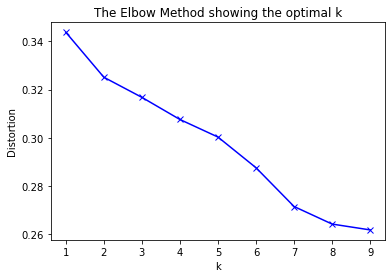

In [114]:
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt

# k means determine k
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(london_grouped_clustering)
    kmeanModel.fit(london_grouped_clustering)
    distortions.append(sum(np.min(cdist(london_grouped_clustering, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / london_grouped_clustering.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [115]:
neighborhoods_venues_sorted.head()

,Location,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue
1,Acton,Hardware Store,Flower Store,Café,Recreation Center,Park,Music Venue,Winery,New American Restaurant,North Indian Restaurant,Noodle Restaurant
2,Addington,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
3,Addiscombe,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
4,Albany Park,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Steakhouse,Monument,Cocktail Bar,Pub,Wine Bar


#### Create a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.

- Adding the cluster label column to TABLE 3

In [116]:
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

london_merged = data

london_merged = london_merged.join(neighborhoods_venues_sorted.set_index('Location'), on='Location')

london_merged

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Bexley,SE2,409888,51.499742,0.124062,0.0,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue
1,Crossness,Bexley,SE2,409888,51.499742,0.124062,0.0,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue
2,West Heath,Bexley,SE2,409888,51.499742,0.124062,0.0,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue
3,Acton,Ealing,W3,518762,51.521205,-0.273975,0.0,Hardware Store,Flower Store,Café,Recreation Center,Park,Music Venue,Winery,New American Restaurant,North Indian Restaurant,Noodle Restaurant
4,Addington,Croydon,CR0,381415,51.384755,-0.051498,5.0,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
5,Addiscombe,Croydon,CR0,381415,51.384755,-0.051498,5.0,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
6,Coombe,Croydon,CR0,381415,51.384755,-0.051498,0.0,Café,Hotel,Pub,Thai Restaurant,Gastropub,Supermarket,Sushi Restaurant,Coffee Shop,Grocery Store,Bookstore
7,Croydon,Croydon,CR0,381415,51.384755,-0.051498,5.0,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
8,Forestdale,Croydon,CR0,381415,51.384755,-0.051498,5.0,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant
9,New Addington,Croydon,CR0,381415,51.384755,-0.051498,5.0,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant


##### There was null value in the merged data so droping the rows with null values

In [117]:
london_merged.dropna(inplace=True)

##### Because of null values the data type of 'Cluster Labels' was changed from int to float so converting it back to int

In [118]:
london_merged['Cluster Labels'] = london_merged['Cluster Labels'].astype(int)
london_merged.dtypes

Location                   object
London_borough             object
Postcode district          object
Avg price                   int64
Latitude                  float64
Longitude                 float64
Cluster Labels              int32
1st Most Common Venue      object
2nd Most Common Venue      object
3rd Most Common Venue      object
4th Most Common Venue      object
5th Most Common Venue      object
6th Most Common Venue      object
7th Most Common Venue      object
8th Most Common Venue      object
9th Most Common Venue      object
10th Most Common Venue     object
dtype: object

### There were many Location that were assigned the same postcodes as they were very near so droping the duplicate postcodes 

In [119]:
london_merged.drop_duplicates(subset='Postcode district',inplace=True)

In [120]:
london_merged.reset_index(inplace=True)
london_merged.drop(columns='index',inplace=True)

## Visualize the clusters

In [144]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=10)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

# Binning

### There is the range of Avg price so binned the price into 7 distinct values

- Low level 1 ==========>  337,359 to 610,243
- Low level 2 ==========>  610,243 to 883,127
- Average level 1 ======>  883,127 to 1,156,011 
- Average level 2 ======>  1,156,011 to 1,428,895
- Above Average ========>  1,428,895 to 1,701,779
- High level 1 =========>  1,701,779 to 1,974,663
- High level 2 =========>  1,974,663 to 2,247,547

Visualizing the bins

Text(0.5, 1.0, 'Price bins')

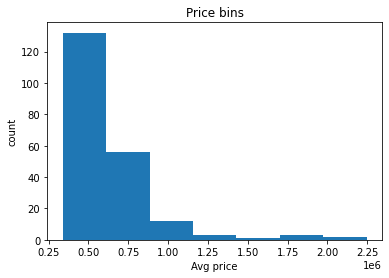

In [122]:
%matplotlib inline
import matplotlib as plt
from matplotlib import pyplot
plt.pyplot.hist(london_merged["Avg price"],bins=7)

# set x/y labels and plot title
plt.pyplot.xlabel("Avg price")
plt.pyplot.ylabel("count")
plt.pyplot.title("Price bins")

In [123]:
bins = np.linspace(min(london_merged["Avg price"]), max(london_merged["Avg price"]), 8)
bins

array([ 337359.,  610243.,  883127., 1156011., 1428895., 1701779.,
       1974663., 2247547.])

In [124]:
group_names = ['Low level 1', 'Low level 2', 'Average level 1', 'Average level 2','Above Average','High level 1','High level 2']

In [125]:
london_merged['Price-Categories'] = pd.cut(london_merged['Avg price'], bins, labels=group_names, include_lowest=True )
london_merged[['Avg price','Price-Categories']].head()

,Avg price,Price-Categories
0,409888,Low level 1
1,518762,Low level 1
2,381415,Low level 1
3,558807,Low level 1
4,478352,Low level 1


## Cluster bins
- Dividing the clusters based on binning and renaming the cluster label
- 0 ==> Mixed Social Venues
- 1 ==> Hotels and Social Venues
- 2 ==> Stores and seafood restaurants
- 3 ==> Pubs and Historic places
- 4 ==> Sports and Athletics
- 5 ==> Restaurants and Bars

Text(0.5, 1.0, 'Cluster Labels')

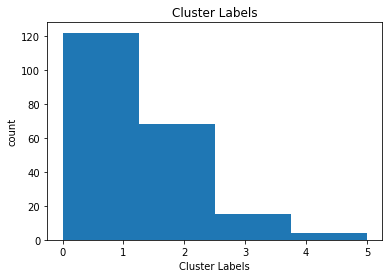

In [126]:
plt.pyplot.hist(london_merged["Cluster Labels"],bins=4)

# set x/y labels and plot title
plt.pyplot.xlabel("Cluster Labels")
plt.pyplot.ylabel("count")
plt.pyplot.title("Cluster Labels")

In [127]:
bins = np.linspace(min(london_merged["Cluster Labels"]), max(london_merged["Cluster Labels"]), 7)
bins

array([0.        , 0.83333333, 1.66666667, 2.5       , 3.33333333,
       4.16666667, 5.        ])

In [128]:
group_names = ['Mixed Social Venues','Hotels and Social Venues','Stores and seafood restaurants','Pubs and Historic places', 'Sports and Athletics','Restaurants and Bars']

In [129]:
london_merged['Cluster-Category'] = pd.cut(london_merged['Cluster Labels'], bins, labels=group_names, include_lowest=True )
london_merged[['Cluster Labels','Cluster-Category']].head()

,Cluster Labels,Cluster-Category
0,0,Mixed Social Venues
1,0,Mixed Social Venues
2,5,Restaurants and Bars
3,2,Stores and seafood restaurants
4,2,Stores and seafood restaurants


# Final Data

In [130]:
london_merged.drop(columns=['6th Most Common Venue','7th Most Common Venue','8th Most Common Venue','9th Most Common Venue','10th Most Common Venue'],inplace=True)
london_merged.head(20)

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
0,Abbey Wood,Bexley,SE2,409888,51.499742,0.124062,0,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Low level 1,Mixed Social Venues
1,Acton,Ealing,W3,518762,51.521205,-0.273975,0,Hardware Store,Flower Store,Café,Recreation Center,Park,Low level 1,Mixed Social Venues
2,Addington,Croydon,CR0,381415,51.384755,-0.051498,5,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,Low level 1,Restaurants and Bars
3,Albany Park,Bexley,DA5,558807,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
4,Aldborough Hatch,Redbridge,IG2,478352,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
5,Aldgate,City,EC3,1049353,51.524100,-0.111650,0,Pub,Coffee Shop,Cocktail Bar,Vietnamese Restaurant,Café,Average level 1,Mixed Social Venues
6,Aldwych,Westminster,WC2,1655181,51.514625,-0.114860,2,Coffee Shop,Pub,Theater,Hotel,Sandwich Spot,Above Average,Stores and seafood restaurants
7,Alperton,Brent,HA0,536768,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
8,Anerley,Bromley,SE20,400610,51.482490,0.119194,2,Campground,Forest,Music Venue,Office Supply Store,North Indian Restaurant,Low level 1,Stores and seafood restaurants
9,Angel,Islington,EC1,833081,51.530130,-0.107969,0,Café,Coffee Shop,Pub,Vietnamese Restaurant,Vegan and Vegetarian Restaurant,Low level 2,Mixed Social Venues


# Creating Chloropleth map to visualize how London is divided in terms of            Housing prices and cluster markers on the top

In [131]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Avg price'],
    key_on='feature.properties.name',
    fill_color='RdPu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average house Prices'
)
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(lnd_map)
       
# display map
lnd_map

C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\folium\folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [132]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Avg price'],
    key_on='feature.properties.name',
    fill_color='RdPu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average house Prices'
)
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(lnd_map)
       
# display map
lnd_map

# Chloropleth map so to see how the London is clustered 

In [133]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Cluster Labels'],
    key_on='feature.properties.name',
    fill_color='PuRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Cluster Labels'
)

lnd_map

# Examining the Clusters

## Cluster 1

In [134]:
london_merged[london_merged['Cluster Labels']==0]
c1_df = london_merged[london_merged['Cluster Labels']==0]
c1_df.to_csv("Cluster_1.csv")

## Cluster 2

In [135]:
london_merged[london_merged['Cluster Labels']==1]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
18,Barkingside,Redbridge,IG6,481115,51.507408,-0.127699,1,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Hotels and Social Venues
19,Barnehurst,Bexley,DA7,464797,51.470520,0.146705,1,Pub,Indian Restaurant,Convenience Store,Forest,Modern European Restaurant,Low level 1,Hotels and Social Venues
20,Barnes,Richmond upon Thames,SW13,1067145,51.472400,-0.244817,1,Pub,Coffee Shop,Pizzeria,Grocery Store,Farmers Market,Average level 1,Hotels and Social Venues
21,Barnes Cray,Bexley,DA1,362000,51.452532,0.168081,1,Pub,Convenience Store,Chinese Restaurant,Bus Stop,Retail,Low level 1,Hotels and Social Venues
73,Church End,Barnet,N3,686101,51.605410,-0.194705,1,Pub,Coffee Shop,Pizzeria,Greek Restaurant,Italian Restaurant,Low level 2,Hotels and Social Venues
74,Clapham,Lambeth,SW4,611819,51.465705,-0.144997,1,Pub,Grocery Store,Coffee Shop,Indian Restaurant,Deli,Low level 2,Hotels and Social Venues
75,Cockfosters,Barnet,EN4,703597,51.640275,-0.157081,1,Coffee Shop,Café,Park,Forest,Pub,Low level 2,Hotels and Social Venues
76,Colindale,Barnet,NW9,460764,51.593619,-0.244623,1,Bus Stop,Supermarket,Metro Station,Pub,Chinese Restaurant,Low level 1,Hotels and Social Venues
116,Goodmayes,Redbridge,IG3,519535,51.507408,-0.127699,1,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Hotels and Social Venues
117,Gospel Oak,Camden,NW5,667260,51.557670,-0.145236,1,Italian Restaurant,Pub,Café,Coffee Shop,Gastropub,Low level 2,Hotels and Social Venues


## Cluster 3

In [136]:
london_merged[london_merged['Cluster Labels']==2]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
3,Albany Park,Bexley,DA5,558807,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
4,Aldborough Hatch,Redbridge,IG2,478352,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
6,Aldwych,Westminster,WC2,1655181,51.514625,-0.114860,2,Coffee Shop,Pub,Theater,Hotel,Sandwich Spot,Above Average,Stores and seafood restaurants
7,Alperton,Brent,HA0,536768,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
8,Anerley,Bromley,SE20,400610,51.482490,0.119194,2,Campground,Forest,Music Venue,Office Supply Store,North Indian Restaurant,Low level 1,Stores and seafood restaurants
12,Ardleigh Green,Havering,RM11,551552,51.583700,0.174760,2,Bus Station,Chinese Restaurant,Furniture and Home Store,Music Store,Electronics Store,Low level 1,Stores and seafood restaurants
16,Bankside,Southwark,SE1,735142,51.500212,-0.115440,2,Hotel,Coffee Shop,Café,Sandwich Spot,Pub,Low level 2,Stores and seafood restaurants
22,Barnet Gate,Barnet,NW7,672414,51.621413,-0.218125,2,Garden Center,Tea Room,Winery,Noodle Restaurant,Night Club,Low level 2,Stores and seafood restaurants
28,Becontree,Barking and Dagenham,RM9,376670,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
29,Becontree Heath,Barking and Dagenham,RM8,378963,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants


## Cluster 4

In [137]:
london_merged[london_merged['Cluster Labels']==3]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
13,Arkley,Barnet,EN5,630074,51.644415,-0.179183,3,Pub,Coffee Shop,Winery,Nail Salon,Okonomiyaki Restaurant,Low level 2,Pubs and Historic places
46,Botany Bay,Enfield,EN2,578707,51.653660,-0.110614,3,Lake,Pub,Flower Store,Winery,Nail Salon,Low level 1,Pubs and Historic places
57,Brondesbury,Brent,NW6,781701,51.533085,-0.195979,3,Pub,Park,Coffee Shop,Tea Room,Middle Eastern Restaurant,Low level 2,Pubs and Historic places
64,Chadwell Heath,Redbridge,RM6,433654,51.573065,0.148225,3,Pub,Retail,Hookah Bar,Winery,Nail Salon,Low level 1,Pubs and Historic places
72,Chislehurst,Bromley,BR7,644932,51.410190,0.060797,3,Pub,Bar,Cave,Winery,New American Restaurant,Low level 2,Pubs and Historic places
84,Cranham,Havering,RM14,602246,51.543071,0.250112,3,Pub,Winery,Music Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Pubs and Historic places
89,Deptford,Lewisham,SE8,425552,51.485760,-0.029205,3,Pub,Harbor or Marina,Fast Food Restaurant,Vietnamese Restaurant,Office Supply Store,Low level 1,Pubs and Historic places
94,Earlsfield,Wandsworth,SW18,662123,51.458807,-0.188133,3,Pub,Coffee Shop,Café,Restaurant,Sandwich Spot,Low level 2,Pubs and Historic places
97,East Finchley,Barnet,N2,890711,51.583820,-0.169589,3,Pub,Landmarks and Outdoors,Convenience Store,Bus Stop,Park,Average level 1,Pubs and Historic places
98,East Sheen,Richmond upon Thames,SW14,887431,51.463938,-0.271400,3,Pub,Coffee Shop,Persian Restaurant,Plaza,Middle Eastern Restaurant,Average level 1,Pubs and Historic places


## Cluster 5

In [138]:
london_merged[london_merged['Cluster Labels']==4]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
55,Bromley,Bromley,BR1,502640,51.416710,0.009041,4,Indian Restaurant,Winery,Music Venue,Office Supply Store,North Indian Restaurant,Low level 1,Sports and Athletics
99,East Wickham,Bexley,DA16,473538,51.459075,0.099121,4,Indian Restaurant,Pizzeria,Resort,Winery,Music Venue,Low level 1,Sports and Athletics


## Cluster 6

In [139]:
london_merged[london_merged['Cluster Labels']==5]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
2,Addington,Croydon,CR0,381415,51.384755,-0.051498,5,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,Low level 1,Restaurants and Bars
185,Rush Green,Barking and Dagenham,RM7,407624,51.574620,0.163153,5,Grocery Store,Race Track,Music Venue,Office Supply Store,North Indian Restaurant,Low level 1,Restaurants and Bars


# Examining Property prices

In [140]:
london_merged[london_merged['Price-Categories']=='High level 2']
HL2_df = london_merged[london_merged['Price-Categories']=='High level 2']
HL2_df.to_csv("High_level_2.csv")
london_merged[london_merged['Price-Categories']=='High level 2']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
69,Chinatown,Westminster,W1,2247547,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,High level 2,Stores and seafood restaurants
148,Kensington,Kensington and Chelsea,SW7,1982547,51.501300,-0.168546,0,Café,Italian Restaurant,Coffee Shop,Hotel,Chinese Restaurant,High level 2,Mixed Social Venues


In [141]:
london_merged[london_merged['Price-Categories']=='High level 1']
HL1_df = london_merged[london_merged['Price-Categories']=='High level 1']
HL1_df.to_csv("High_level_1.csv")
london_merged[london_merged['Price-Categories']=='High level 1']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
32,Belgravia,Westminster,SW1,1711873,51.489360,-0.136190,0,Pub,Hotel,Bakery,Turkish Restaurant,Pizzeria,High level 1,Mixed Social Venues
56,Brompton,Kensington and Chelsea,SW3,1904191,51.498105,-0.165170,0,Café,Hotel,Boutique,Italian Restaurant,Coffee Shop,High level 1,Mixed Social Venues
140,Holland Park,Kensington and Chelsea,W8,1790606,51.505330,-0.191053,2,Pub,Hotel,Restaurant,Garden,Italian Restaurant,High level 1,Stores and seafood restaurants


In [142]:
london_merged[london_merged['Price-Categories']=='Low level 2']
LL2_df = london_merged[london_merged['Price-Categories']=='Low level 2']
LL2_df.to_csv("Low_level_2.csv")
london_merged[london_merged['Price-Categories']=='Low level 2']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
9,Angel,Islington,EC1,833081,51.530130,-0.107969,0,Café,Coffee Shop,Pub,Vietnamese Restaurant,Vegan and Vegetarian Restaurant,Low level 2,Mixed Social Venues
13,Arkley,Barnet,EN5,630074,51.644415,-0.179183,3,Pub,Coffee Shop,Winery,Nail Salon,Okonomiyaki Restaurant,Low level 2,Pubs and Historic places
15,Balham,Wandsworth,SW12,720545,51.446365,-0.137480,0,Housing Development,Retail,Park,Winery,Nail Salon,Low level 2,Mixed Social Venues
16,Bankside,Southwark,SE1,735142,51.500212,-0.115440,2,Hotel,Coffee Shop,Café,Sandwich Spot,Pub,Low level 2,Stores and seafood restaurants
22,Barnet Gate,Barnet,NW7,672414,51.621413,-0.218125,2,Garden Center,Tea Room,Winery,Noodle Restaurant,Night Club,Low level 2,Stores and seafood restaurants
23,Barnsbury,Islington,N1,717078,51.545663,-0.081970,0,Pub,Café,Coffee Shop,Wine Bar,Cocktail Bar,Low level 2,Mixed Social Venues
31,Bedford Park,Ealing,W4,862943,51.497765,-0.255852,0,Coffee Shop,Park,French Restaurant,Comedy Club,Mediterranean Restaurant,Low level 2,Mixed Social Venues
42,Blackfriars,City,EC4,875776,51.515400,-0.104903,2,Pub,Coffee Shop,Italian Restaurant,Sandwich Spot,French Restaurant,Low level 2,Stores and seafood restaurants
45,Bloomsbury,Camden,WC1,864712,51.517165,-0.126810,2,Theater,Coffee Shop,Bakery,Hotel,Bookstore,Low level 2,Stores and seafood restaurants
57,Brondesbury,Brent,NW6,781701,51.533085,-0.195979,3,Pub,Park,Coffee Shop,Tea Room,Middle Eastern Restaurant,Low level 2,Pubs and Historic places


In [143]:
london_merged[london_merged['Price-Categories']=='Low level 1']
LL1_df = london_merged[london_merged['Price-Categories']=='Low level 1']
LL1_df.to_csv("Low_level_1.csv")
london_merged[london_merged['Price-Categories']=='Low level 1']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
0,Abbey Wood,Bexley,SE2,409888,51.499742,0.124062,0,Lake,Nail Salon,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Low level 1,Mixed Social Venues
1,Acton,Ealing,W3,518762,51.521205,-0.273975,0,Hardware Store,Flower Store,Café,Recreation Center,Park,Low level 1,Mixed Social Venues
2,Addington,Croydon,CR0,381415,51.384755,-0.051498,5,Grocery Store,Art Gallery,Winery,Nail Salon,Office Supply Store,Low level 1,Restaurants and Bars
3,Albany Park,Bexley,DA5,558807,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
4,Aldborough Hatch,Redbridge,IG2,478352,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
7,Alperton,Brent,HA0,536768,51.507408,-0.127699,2,Theater,Hotel,Plaza,Italian Restaurant,Art Gallery,Low level 1,Stores and seafood restaurants
8,Anerley,Bromley,SE20,400610,51.482490,0.119194,2,Campground,Forest,Music Venue,Office Supply Store,North Indian Restaurant,Low level 1,Stores and seafood restaurants
10,Aperfield,Bromley,TN16,561400,51.276121,0.074362,0,Fuel Station,Veterinarian,Winery,Music Store,North Indian Restaurant,Low level 1,Mixed Social Venues
11,Archway,Islington,N19,574570,51.532760,-0.114007,0,Café,Coffee Shop,Pub,Italian Restaurant,Cocktail Bar,Low level 1,Mixed Social Venues
12,Ardleigh Green,Havering,RM11,551552,51.583700,0.174760,2,Bus Station,Chinese Restaurant,Furniture and Home Store,Music Store,Electronics Store,Low level 1,Stores and seafood restaurants
